packages install

In [1]:
!pip install albumentations==0.4.6

In [2]:
%cd '/content/drive/MyDrive/Colab Notebooks/Plant_Pathology'

/content/drive/MyDrive/Colab Notebooks/Plant_Pathology


# We can't do everything by ourselves, 

# let's import some libraries 🛒🛒

In [3]:
from glob import glob
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import cv2

# for path in tqdm(glob('data/train_images_l/*.jpg')):
#     p_name = path.rsplit('/', 1)[1]

#     img = plt.imread(path)
#     img = cv2.resize(img, (224,224))
#     plt.imsave(f'data/train_images/{p_name}', img)
# #     # plt.imsave(f'data/train_images/{p_name}',
# #     #     plt.imread(path)
# #     # )
# #     # print(path)
    


In [4]:
import os
import cv2
import random
import warnings
import torchvision
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from insectAug import InsectAugmentation
from torch.utils.data import Dataset, DataLoader
import albumentations as A
from albumentations import (
    Compose, OneOf, Resize, Normalize,
    # color augmentaion:
    RandomBrightness, RandomContrast,
    RandomBrightnessContrast, ToGray, HueSaturationValue,

    # wether augmentation:
    RandomFog, 
    RandomShadow, RandomRain, RandomSunFlare,

    # geomatric transforms:
    HorizontalFlip, VerticalFlip, RandomRotate90,

    # Blur:
    Blur, MotionBlur, MedianBlur, 

    # noise and cut:
    Cutout, 
    CoarseDropout,
      MultiplicativeNoise, GaussNoise, CLAHE, ISONoise, MultiplicativeNoise     
)
from albumentations.pytorch.transforms import ToTensorV2

warnings.filterwarnings('ignore')

# Let's have a look on the plant pathology raw dataset🤓

We can see that the we working with multi-label dataset, each row may has couple of labels

In [5]:
df = pd.read_csv("data/train.csv")
display(df.head(10))

,image,labels
0,800113bb65efe69e.jpg,healthy
1,8002cb321f8bfcdf.jpg,scab frog_eye_leaf_spot complex
2,80070f7fb5e2ccaa.jpg,scab
3,80077517781fb94f.jpg,scab
4,800cbf0ff87721f8.jpg,complex
5,800edef467d27c15.jpg,healthy
6,800f85dc5f407aef.jpg,rust
7,801d6dcd96e48ebc.jpg,healthy
8,801f78399a44e7af.jpg,complex
9,8021b94d437eb7d3.jpg,healthy


# distribution of the labels 📊 
there are 6 main labels and six more combinations of those labels.

Furthermore, the data is unbalanced and we had to solve it

In [6]:
print(df['labels'].value_counts())

scab                               4826
healthy                            4624
frog_eye_leaf_spot                 3181
rust                               1860
complex                            1602
powdery_mildew                     1184
scab frog_eye_leaf_spot             686
scab frog_eye_leaf_spot complex     200
frog_eye_leaf_spot complex          165
rust frog_eye_leaf_spot             120
rust complex                         97
powdery_mildew complex               87
Name: labels, dtype: int64


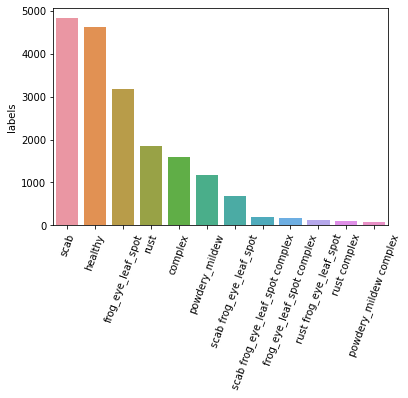

In [7]:
labels_hist = sns.barplot(df.labels.value_counts().index, 
                          df.labels.value_counts())
for item in labels_hist.get_xticklabels():
    item.set_rotation(70)

In [8]:
fig = go.Figure(data=[go.Pie(labels=df['labels'].value_counts().index, 
                             values=df['labels'].value_counts().values)])
fig.update_layout(title='Label distribution')
fig.show()

Stratefied split basically preserves the class distribution. When we look at how StratifiedKFold splits the dataset, we saw that it only accepts a one-dimensional target variable, whereas we are trying to pass a target variable with dimensions [n_samples, n_classes].
To deal with this, we perform stratified sampling on the each of the unique label bins.

In [9]:
all_labels = {
              'scab':[], 
              'healthy':[],
              'frog_eye_leaf_spot':[],
              'rust':[], 
              'complex':[], 
              'powdery_mildew':[], 
              'scab frog_eye_leaf_spot':[], 
              'scab frog_eye_leaf_spot complex':[],
              'frog_eye_leaf_spot complex':[], 
              'rust frog_eye_leaf_spot':[], 
              'rust complex':[],
              'powdery_mildew complex':[]
}
for image_data, label_data in df.values:
    for label in all_labels.keys():
        if label_data == label:
            all_labels[label_data].append(image_data)


train_df = pd.DataFrame()
val_df = pd.DataFrame()

for label, paths in all_labels.items():
    np.random.shuffle(paths)
    train_len = round(len(paths)*0.8)
    # val_len = len(paths) - train_len
    train_paths = paths[:train_len]
    val_paths = paths[train_len:]
    print(f'** {label} total appearances: {len(paths)}')
    print('\ttrain split: ', len(train_paths))
    print('\tvalidition split: ', len(val_paths))


    for path in train_paths:
        tmp_list = [path, label]
        train_df = train_df.append(pd.Series(tmp_list, index= df.columns), ignore_index=True)

    for path in val_paths:
        tmp_list = [path, label]
        val_df = val_df.append(pd.Series(tmp_list, index= df.columns), ignore_index=True)

## Save the splitting dataset for future working
# train_df.to_csv(f'data/stratifiedkfold_train.csv', index=False)
# val_df.to_csv(f'data/stratifiedkfold_val.csv', index=False)

** scab total appearances: 4826
	train split:  3861
	validition split:  965
** healthy total appearances: 4624
	train split:  3699
	validition split:  925
** frog_eye_leaf_spot total appearances: 3181
	train split:  2545
	validition split:  636
** rust total appearances: 1860
	train split:  1488
	validition split:  372
** complex total appearances: 1602
	train split:  1282
	validition split:  320
** powdery_mildew total appearances: 1184
	train split:  947
	validition split:  237
** scab frog_eye_leaf_spot total appearances: 686
	train split:  549
	validition split:  137
** scab frog_eye_leaf_spot complex total appearances: 200
	train split:  160
	validition split:  40
** frog_eye_leaf_spot complex total appearances: 165
	train split:  132
	validition split:  33
** rust frog_eye_leaf_spot total appearances: 120
	train split:  96
	validition split:  24
** rust complex total appearances: 97
	train split:  78
	validition split:  19
** powdery_mildew complex total appearances: 87
	train sp

# Change labels to categorical indices

In [10]:
#load train/val datasets
train_df = pd.read_csv("data/stratifiedkfold_train.csv", index_col=False)
val_df = pd.read_csv("data/stratifiedkfold_val.csv", index_col=False)

#shuffle 
train_df = train_df.sample(frac=1)
val_df = val_df.sample(frac=1)

# Train distribution

In [11]:
train_df['labels'].value_counts()

scab                               3861
healthy                            3699
frog_eye_leaf_spot                 2545
rust                               1488
complex                            1282
powdery_mildew                      947
scab frog_eye_leaf_spot             549
scab frog_eye_leaf_spot complex     160
frog_eye_leaf_spot complex          132
rust frog_eye_leaf_spot              96
rust complex                         78
powdery_mildew complex               70
Name: labels, dtype: int64

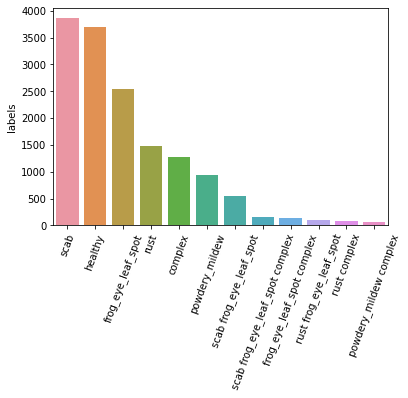

In [12]:
labels_hist = sns.barplot(train_df.labels.value_counts().index, 
                          train_df.labels.value_counts())
for item in labels_hist.get_xticklabels():
    item.set_rotation(70)

In [13]:
fig = go.Figure(data=[go.Pie(labels=train_df['labels'].value_counts().index, 
                             values=train_df['labels'].value_counts().values)])
fig.update_layout(title='Label distribution')
fig.show()

# Validition distribution

In [14]:
val_df['labels'].value_counts()

scab                               965
healthy                            925
frog_eye_leaf_spot                 636
rust                               372
complex                            320
powdery_mildew                     237
scab frog_eye_leaf_spot            137
scab frog_eye_leaf_spot complex     40
frog_eye_leaf_spot complex          33
rust frog_eye_leaf_spot             24
rust complex                        19
powdery_mildew complex              17
Name: labels, dtype: int64

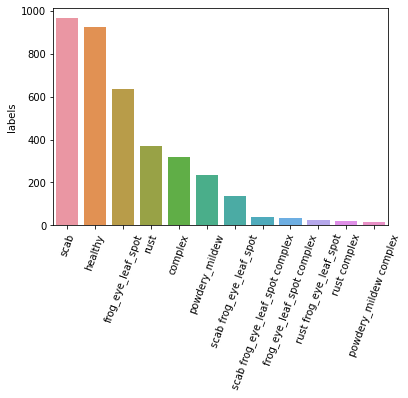

In [15]:
labels_hist = sns.barplot(val_df.labels.value_counts().index,
                          val_df.labels.value_counts())
for item in labels_hist.get_xticklabels():
    item.set_rotation(70)

In [16]:
fig = go.Figure(data=[go.Pie(labels=val_df['labels'].value_counts().index,
                             values=val_df['labels'].value_counts().values)])
fig.update_layout(title='Label distribution')
fig.show()

# Data Frame Encoding


In [17]:
# Backup original data
train_df_cp = train_df.copy()
val_df_cp = train_df.copy()

In [18]:
# Convert labels from long string to labels list
train_df_cp['label_list'] = train_df_cp['labels'].str.split(' ')
val_df_cp['label_list'] = val_df_cp['labels'].str.split(' ')

In [19]:
def lbl_lgc(col,lbl_list):
    if col in lbl_list:
        res = 1 
    else:
        res = 0
    return res

In [20]:
lbls = ['healthy','complex','rust','frog_eye_leaf_spot','powdery_mildew','scab']

# create a separate column for each label
for x in lbls:
    train_df_cp[x]=0
    val_df_cp[x]=0

# fill one's at the relevant position
for x in lbls:
    train_df_cp[x] = np.vectorize(lbl_lgc)(x,train_df_cp['label_list'])
    val_df_cp[x] = np.vectorize(lbl_lgc)(x,val_df_cp['label_list'])

In [ ]:
train_df_cp.head()

,image,labels,label_list,healthy,complex,rust,frog_eye_leaf_spot,powdery_mildew,scab
9497,85d027d8ed068e3f.jpg,frog_eye_leaf_spot,[frog_eye_leaf_spot],0,0,0,1,0,0
9577,ff96c03ec0e10bc3.jpg,frog_eye_leaf_spot,[frog_eye_leaf_spot],0,0,0,1,0,0
9741,fef4e0b9c3b8c088.jpg,frog_eye_leaf_spot,[frog_eye_leaf_spot],0,0,0,1,0,0
1045,86a585eb87c61f4c.jpg,scab,[scab],0,0,0,0,0,1
859,fb5ce1f807c150e2.jpg,scab,[scab],0,0,0,0,0,1


In [ ]:
val_df_cp.head()

,image,labels,label_list,healthy,complex,rust,frog_eye_leaf_spot,powdery_mildew,scab
1141,d10f693164819ff5.jpg,scab,[scab],0,0,0,0,0,1
3945,b4bbb596e3809253.jpg,healthy,[healthy],1,0,0,0,0,0
2894,fae98d4995c34a31.jpg,scab,[scab],0,0,0,0,0,1
11481,96c26a361786f39c.jpg,rust,[rust],0,0,1,0,0,0
6381,b4d282a54b5e555e.jpg,healthy,[healthy],1,0,0,0,0,0


With this finall step we finished preprocceing the raw data🤮


# Finally we can see some images!


In [22]:
def display_images(train_path,labels,rows,cols):
    
    for i in range(rows):
        fig = plt.figure(figsize=(20, 40))
        df = list(train_df.loc[train_df['labels'] == labels[i]]['image'])
        fontsize=25
        label = str(labels[i])
        if len(label) > 15:
            label = label.replace(' ', '\n')
            fontsize=15
        try:
            label = label.replace('_', ' ')
        except:
            pass
        cat_images = []
        for j in range(cols):
            img_path = df[j]
            img = cv2.imread(os.path.join(train_path,img_path))
            img = cv2.resize(img, (512, 512))
            cat_images.append(img)
        
        stack_images = cv2.hconcat(cat_images)
        image = cv2.cvtColor(stack_images, cv2.COLOR_BGR2RGB)
        plt.imshow(image)
        plt.axis('off')
        plt.title(label, fontsize=fontsize)
        plt.show()

            # idx += 1


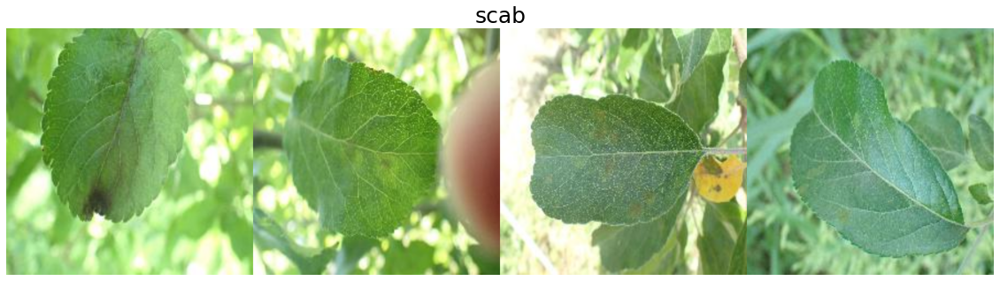

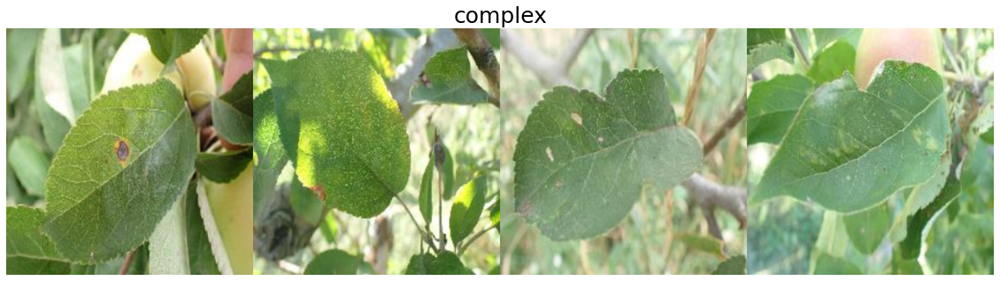

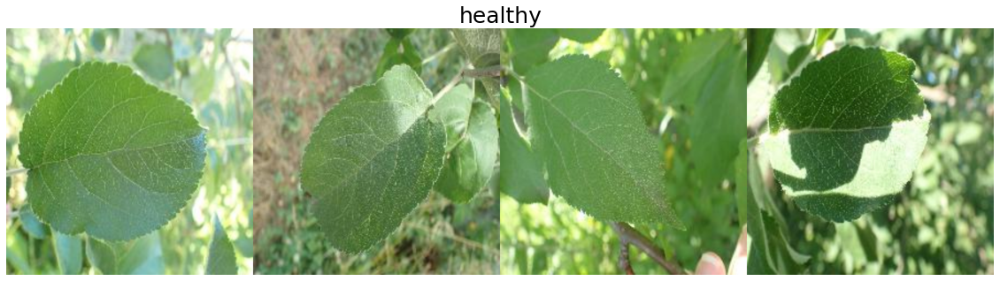

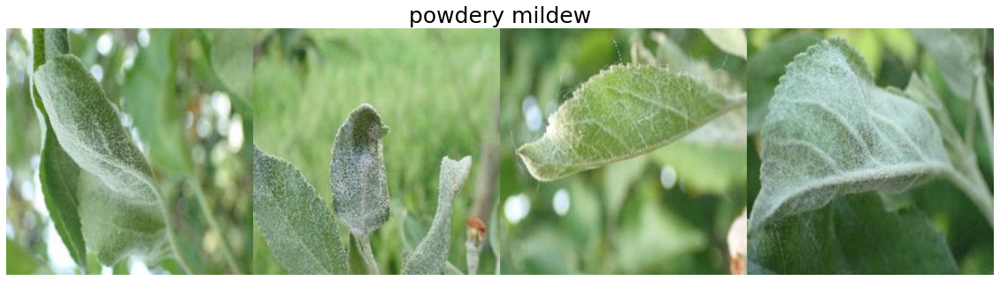

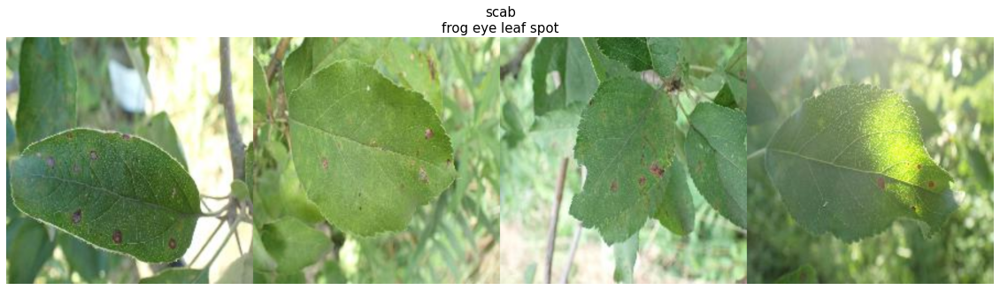

...

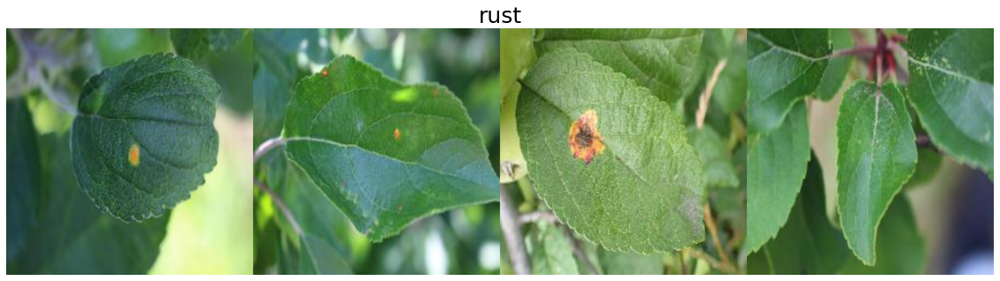

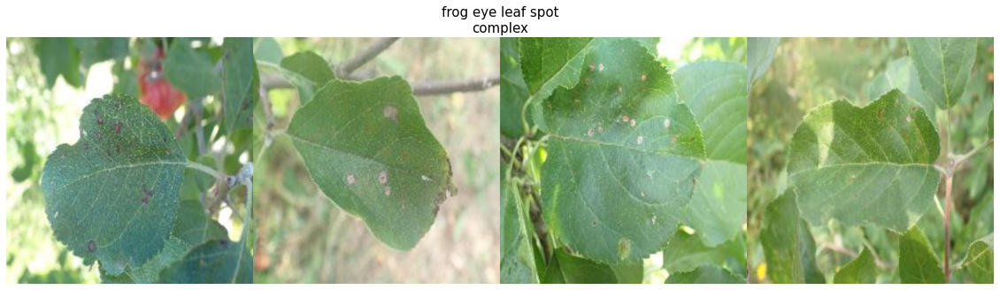

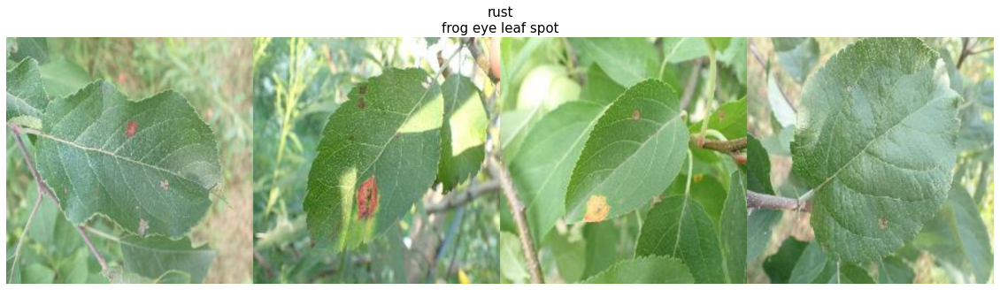

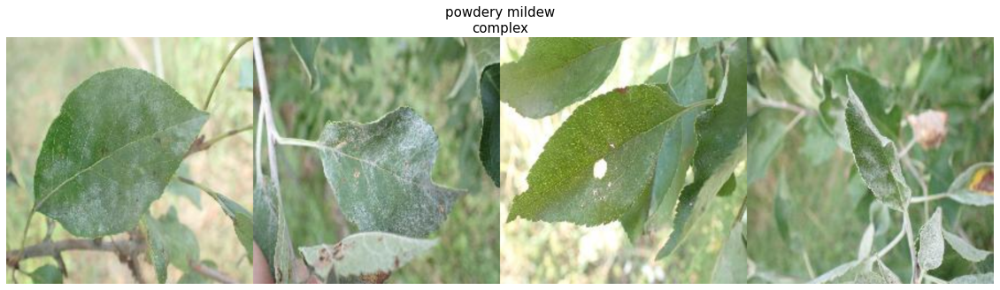

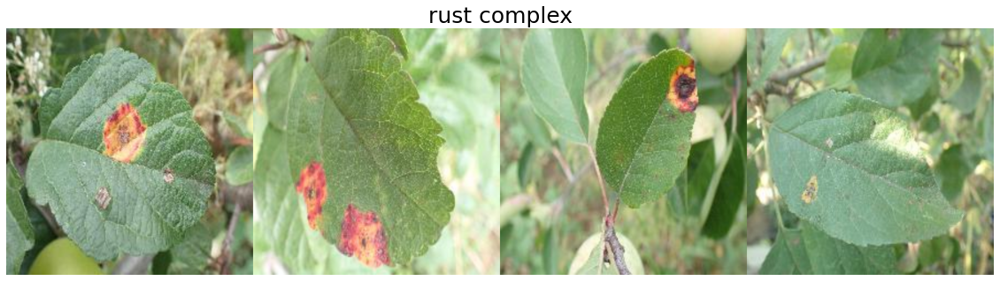

In [23]:
train_image_path = 'data/train_images'
labels_arr = train_df['labels'].unique()
display_images(train_image_path, labels_arr, 12, 4)

# The Plant Dataset Class

In [ ]:
class Plant_Dataset(Dataset):
    def __init__(self, folder_path, data_df, transforms=None, train=True):
        self.folder_path = folder_path
        self.data_df = data_df
        self.transforms = transforms
        self.train = train

    def __getitem__(self, idx):

        img_path = os.path.join(self.folder_path, self.data_df.iloc[idx, 0])
        image = cv2.imread(img_path) 

        if self.train:   # generate multi label vector for train/val ground truth   
            vector = [0]*6
            values = self.data_df.loc[self.data_df['image'] == self.data_df.iloc[idx, 0]].values
            for i in range(3,9):
                num = values[0][i]
                vector[i-3] = num
            vector = np.asarray(vector)
        if self.transforms:
            augmented = self.transforms(image=image)
            image = augmented['image']

        if self.train:
            return image, vector # Train\Validation data
        else:
            return image,self.data_df.iloc[idx, 0] # Test data


    def __len__(self):
            return len(self.data_df)  



In [ ]:
def normalize8(I):
    mn = I.min()
    mx = I.max()

    mx -= mn

    I = ((I - mn)/mx) * 255
    return I.astype(np.uint8)

def show_transforms(transforms,bs=8,nrow=2, to_inv=False):
    train_data = Plant_Dataset("data/train_images", 
                            train_df_cp, 
                            transforms=transforms,
                            train=True)

    # print(len(train_data))
    loader_train = DataLoader(train_data, 
                            batch_size=bs, 
                            shuffle=False, 
                            num_workers=4)
    imgs = next(iter(loader_train))
    plt.figure(figsize=(20,10))
    batch = torchvision.utils.make_grid(imgs[0], nrow=nrow).permute(2, 1, 0).detach().cpu().numpy()
    batch = cv2.cvtColor(batch, cv2.COLOR_BGR2RGB)
    plt.imshow(batch)
    plt.axis('off')
    plt.show()
    if to_inv:
        return batch
 

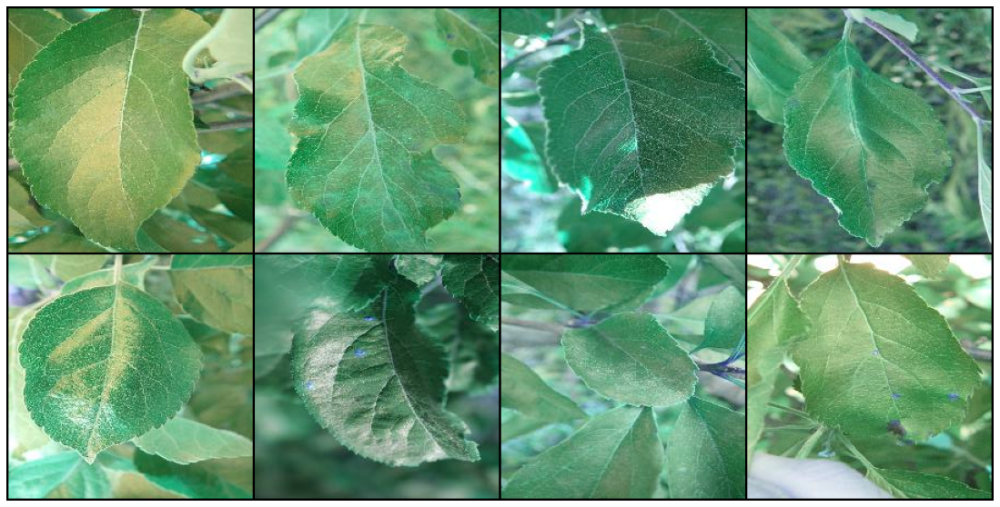

In [ ]:
train_transform = A.Compose([  
    ToTensorV2(),
])

show_transforms(train_transform)

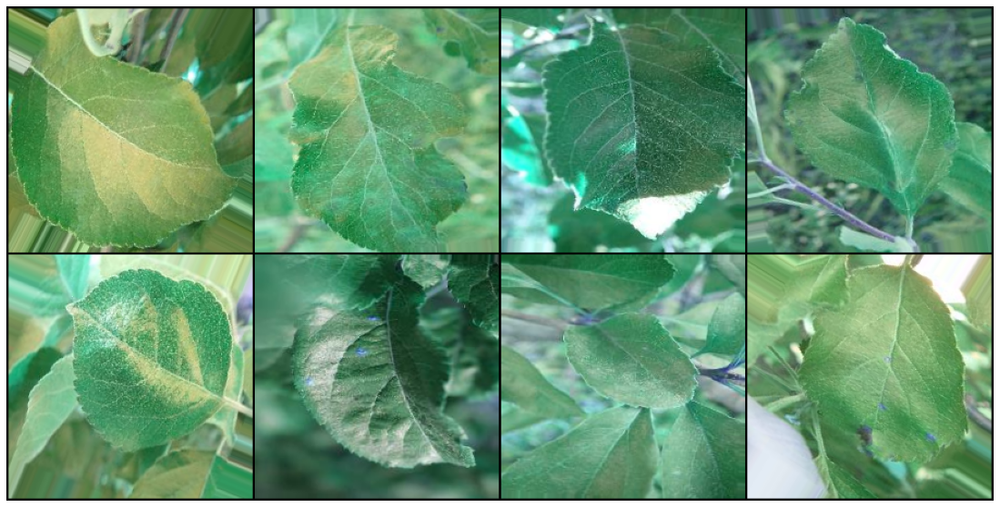

In [ ]:
train_transform = A.Compose([
    A.Rotate(
        always_apply=True, 
        p=1., 
        limit=(-68, 178), 
        interpolation=1, 
        border_mode=1, 
        # value=(0, 0, 0), 
        mask_value=None
    ),
    
    ToTensorV2(),
])
show_transforms(train_transform)

# Weather

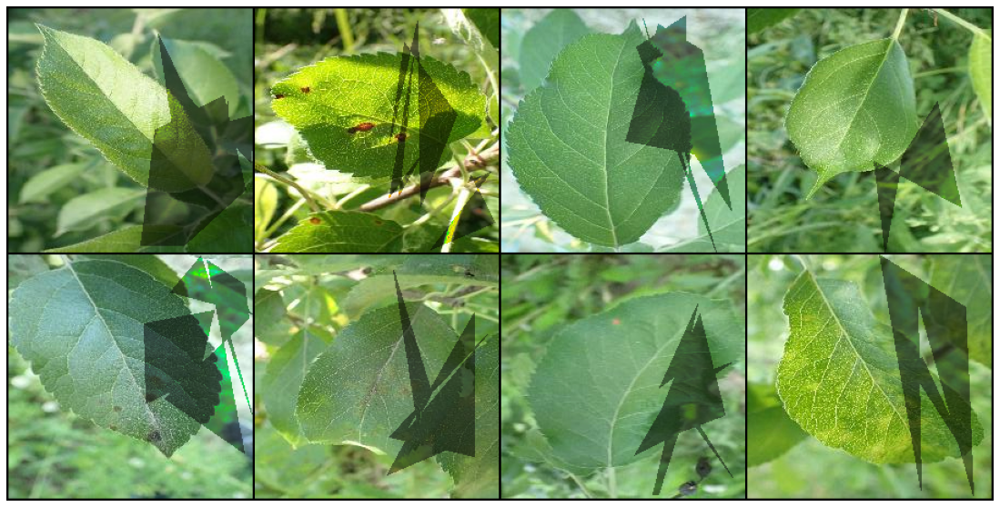

In [ ]:
train_transform = A.Compose([
    A.RandomShadow(
        num_shadows_lower=1, 
        num_shadows_upper=3, 
        shadow_dimension=5, 
        p=1.,
        always_apply=True
    ),
    ToTensorV2(),
])
show_transforms(train_transform)

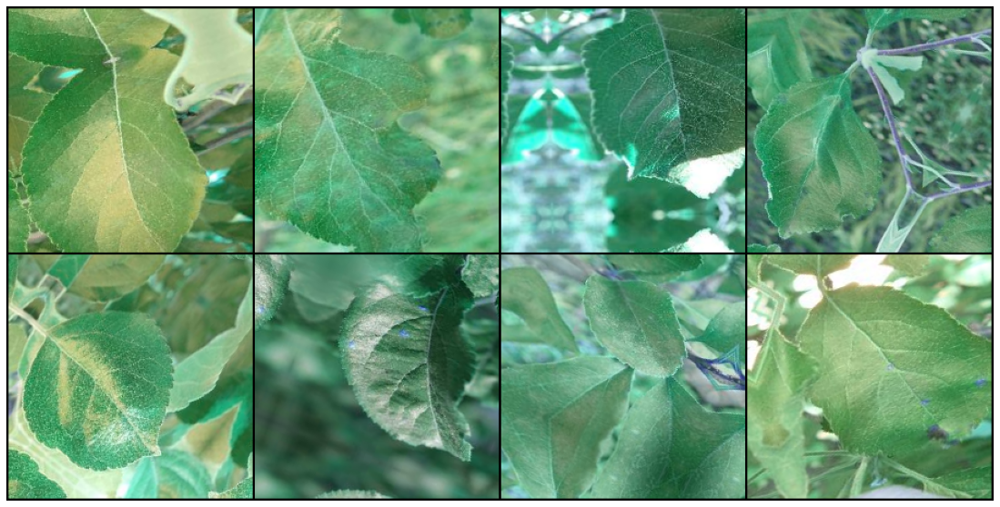

In [ ]:
train_transform = A.Compose([

    A.ShiftScaleRotate(
        shift_limit=0.2, 
        scale_limit=0.2, 
        rotate_limit=90, 
        p=1.,
        always_apply=True
    ),
    
    ToTensorV2(),
])
show_transforms(train_transform)

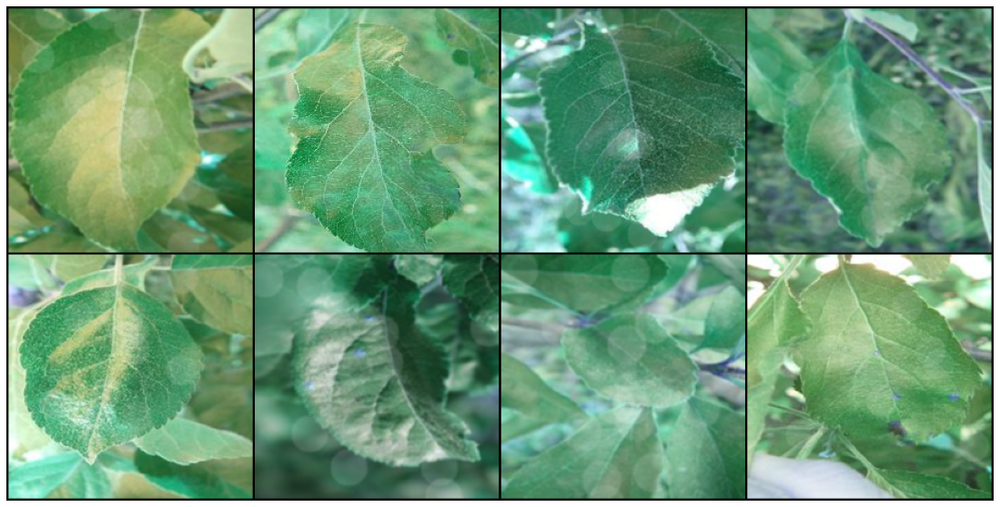

In [ ]:
train_transform = A.Compose([
   
    A.RandomFog(
        fog_coef_lower=0.2, 
        fog_coef_upper=0.5, 
        alpha_coef=0.3, 
        p=1.,
        always_apply=True
    ),
   
    ToTensorV2(),
])
show_transforms(train_transform)

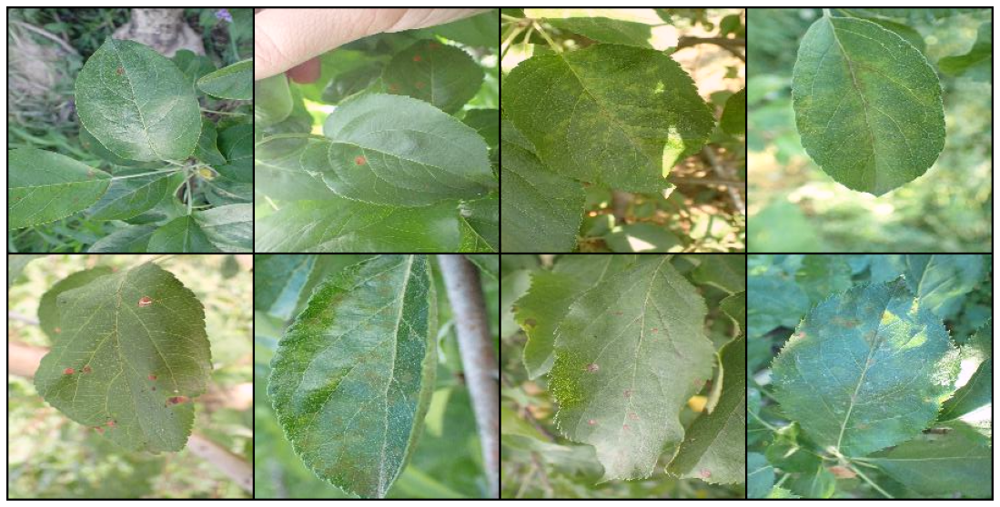

In [ ]:
train_transform = A.Compose([
    A.RGBShift(
        r_shift_limit=20, 
        g_shift_limit=20, 
        b_shift_limit=20, 
        always_apply=True,
        p=1.
    ),
    ToTensorV2(),
])

show_transforms(train_transform)

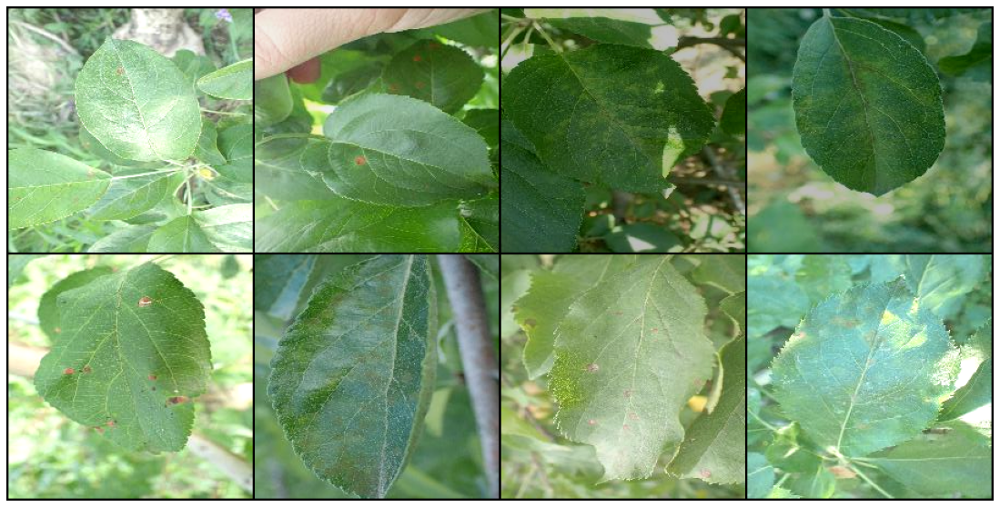

In [ ]:
train_transform = A.Compose([
    A.RandomBrightnessContrast(
        always_apply=True,
        p=1.
    ),
    
    ToTensorV2(),
])
show_transforms(train_transform)

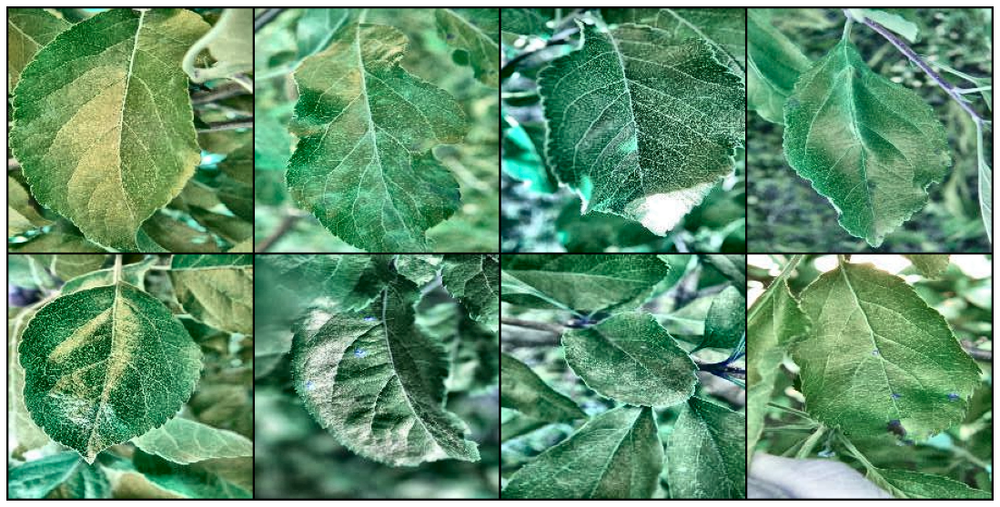

In [ ]:
train_transform = A.Compose([
    A.CLAHE(
        always_apply=True,
        p=1.
    ),
    
    ToTensorV2(),
])
show_transforms(train_transform)

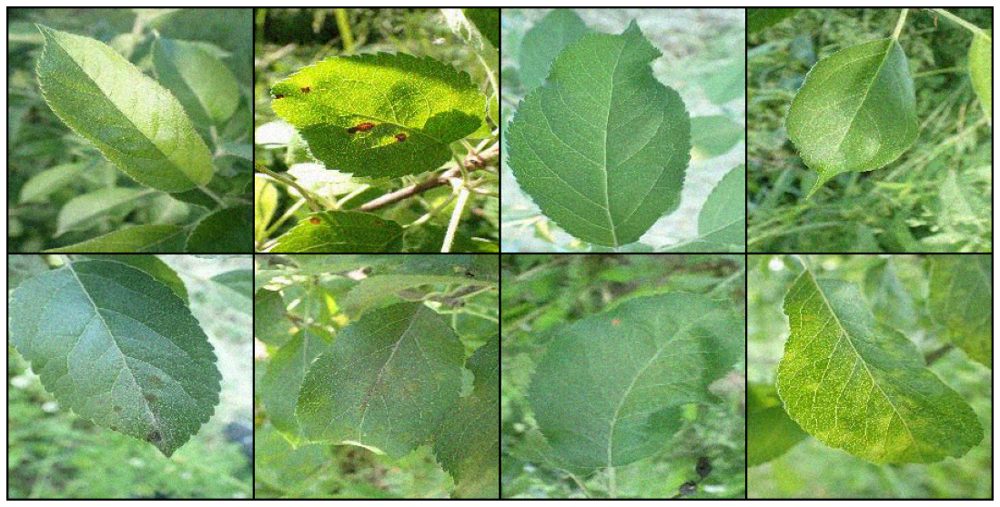

In [ ]:
train_transform = A.Compose([
    A.GaussNoise(
        var_limit=(100, 170),  
        always_apply=True,
        p=1.
    ),
    ToTensorV2(),
])
show_transforms(train_transform)


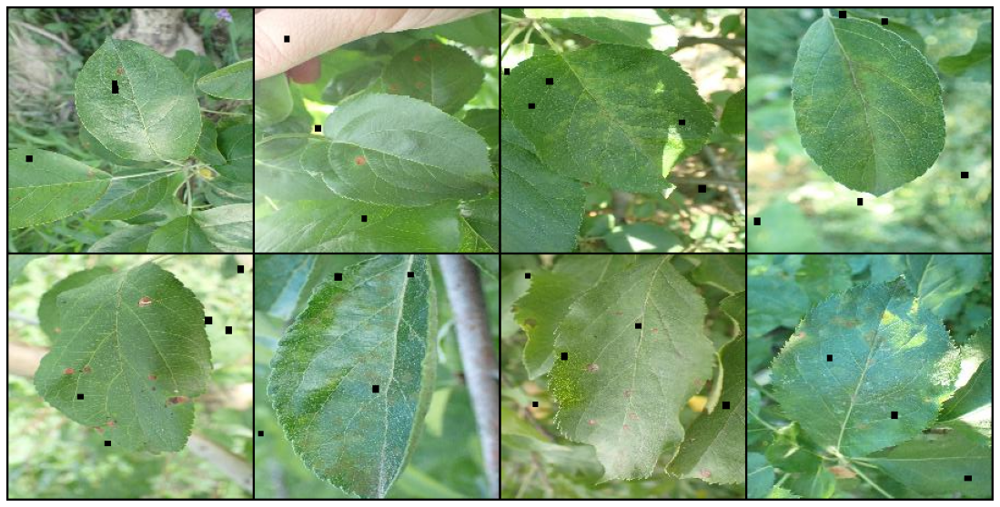

In [ ]:
train_transform = A.Compose([
    A.CoarseDropout(
        max_holes=5, 
        max_height=7, 
        max_width=7, 
        min_holes=3, 
        min_height=5, 
        min_width=5,
        always_apply=True,
        p=1.
    ),
    ToTensorV2(),
])
show_transforms(train_transform)



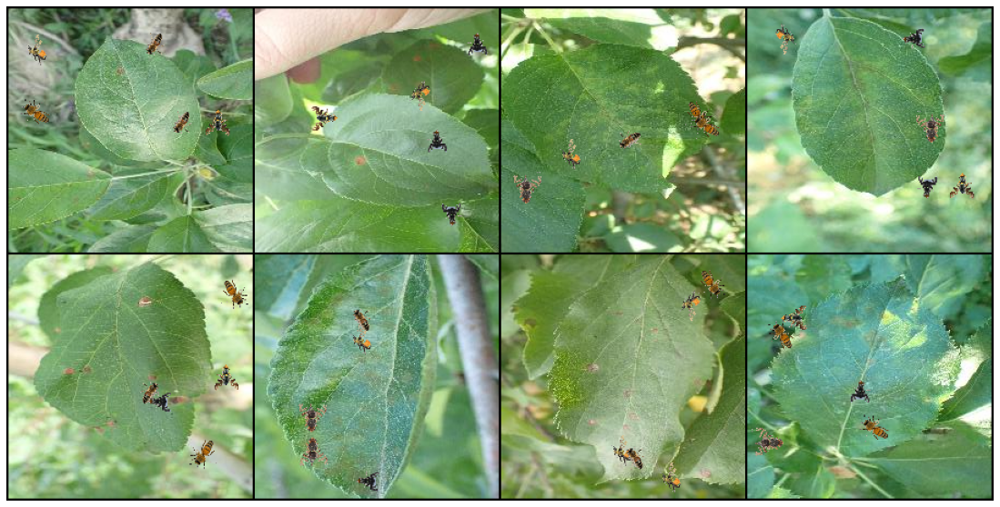

In [ ]:
insect_transforms = Compose([
                            InsectAugmentation(insects=5, always_apply=True, p=1.),
                            ToTensorV2()])
show_transforms(insect_transforms)

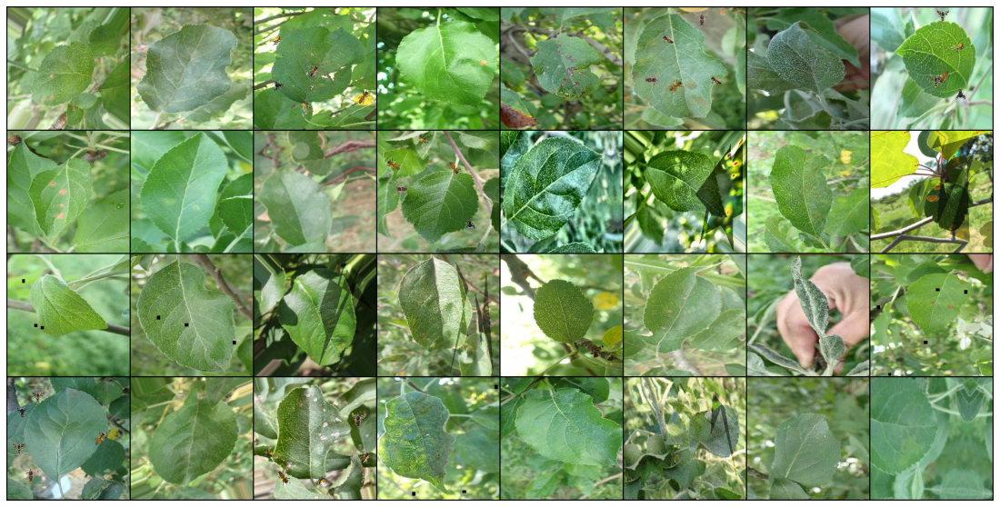

In [ ]:
train_transform = A.Compose([
OneOf([
       A.Rotate( 
            limit=(-68, 178), 
            interpolation=1, 
            border_mode=1, 
            mask_value=None),
        A.ShiftScaleRotate(
            shift_limit=0.2, 
            scale_limit=0.2, 
            rotate_limit=90)]),
OneOf([
       InsectAugmentation(insects=5),
       A.CoarseDropout(
            max_holes=5, 
            max_height=7, 
            max_width=7, 
            min_holes=3, 
            min_height=5, 
            min_width=5),
        A.RandomShadow(
            num_shadows_lower=1, 
            num_shadows_upper=3, 
            shadow_dimension=5)
        ]),
OneOf([
        A.RandomFog(
            fog_coef_lower=0.2, 
            fog_coef_upper=0.5, 
            alpha_coef=0.3),
        A.CLAHE(),
        A.RandomBrightnessContrast(),
        A.RGBShift(
            r_shift_limit=20, 
            g_shift_limit=20, 
            b_shift_limit=20),
        A.GaussNoise(
            var_limit=(100, 170))]),
        # A.Normalize(
        #     mean=(0.485, 0.456, 0.406), 
        #     std=(0.229, 0.224, 0.225)),
        ToTensorV2()])
show_transforms(train_transform, bs=32, nrow=4)